In [2]:
import numpy as np
import matplotlib.pyplot as plt
from collections import Counter
import pandas as pd

import common as cmn

[nltk_data] Downloading package stopwords to
[nltk_data]     /home/djeghali/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /home/djeghali/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /home/djeghali/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.2.0) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "


# B) Extraction du vocabulaire (BoW)

- **Exploration préliminaire des jeux de données**
    - Quelle est la taille d'origine du vocabulaire?
    - Que reste-t-il si on ne garde que les 100 mots les plus fréquents? [word cloud]
    - Quels sont les 100 mots dont la fréquence documentaire est la plus grande? [word cloud]
    - Quels sont les 100 mots les plus discriminants au sens de odds ratio? [word cloud]
    - Quelle est la distribution d'apparition des mots (Zipf)
    - Quels sont les 100 bigrammes/trigrammes les plus fréquents?



### Chargement des données :

In [3]:
fname = "./datasets/AFDpresidentutf8/corpus.tache1.learn.utf8"
alltxts,alllabs = cmn.load_pres(fname)
print(len(alltxts),len(alllabs))
print(alltxts[0])
print(alllabs[0])
print(alltxts[-1])
print(alllabs[-1])

# Création d'un dataframe pour notre base de données :
data_frame_discours = pd.DataFrame()
data_frame_discours['text'] = alltxts
data_frame_discours['label'] = alllabs
data_frame_discours

tx1t <100:1:C> Quand je dis chers amis, il ne s'agit pas là d'une formule diplomatique, mais de l'expression de ce que je ressens.

lab C

txt2  Quand je dis chers amis, il ne s'agit pas là d'une formule diplomatique, mais de l'expression de ce que je ressens.

tx1t <100:2:C> D'abord merci de cet exceptionnel accueil que les Congolais, les Brazavillois, nous ont réservé cet après-midi.

lab C

txt2  D'abord merci de cet exceptionnel accueil que les Congolais, les Brazavillois, nous ont réservé cet après-midi.

tx1t <100:3:C> C'est toujours très émouvant de venir en Afrique car c'est probablement l'une des rares terres du monde où l'on ait conservé cette convivialité, cette amitié, ce respect de l'autre qui s'expriment avec chaleur, avec spontanéité et qui réchauffent le coeur de ceux qui arrivent et de ceux qui reçoivent.

lab C

txt2  C'est toujours très émouvant de venir en Afrique car c'est probablement l'une des rares terres du monde où l'on ait conservé cette convivialité, cette a

,text,label
0,"Quand je dis chers amis, il ne s'agit pas là ...",1
1,D'abord merci de cet exceptionnel accueil que...,1
2,C'est toujours très émouvant de venir en Afri...,1
3,Aucun citoyen français ne peut être indiffére...,1
4,"Le Congo, que naguère le <nom> qualifia de ""r...",1
...,...,...
57408,Je suis heureux de le mener avec vous.\n,1
57409,"Vous le savez, comme vous, j'ai la passion de...",1
57410,Je crois en son avenir.\n,1
57411,"Je crois en la politique, c'est-à-dire en not...",1


#### -    Exploration préliminaire des jeux de données :

In [4]:
from sklearn.feature_extraction.text import CountVectorizer,TfidfVectorizer


-  Taille initiale du vocabulaire : 

In [19]:
vectorizer_1 = CountVectorizer()
corpus_dicours = data_frame_discours.text
corpus_dicours_sparse_mat = vectorizer_1.fit_transform(corpus_dicours) # Output is a sparse matrix
print("Taille initiale du vocabulaire :",len(vectorizer_1.get_feature_names_out()))



Taille initiale du vocabulaire : 28524


-   Que reste-t-il si on ne garde que les 100 mots les plus fréquents? 

[('', 300884), ('de', 68632), ('la', 39753), ('et', 35185), ('l', 34307), ('à', 26938), ('le', 24369), ('les', 24362), ('des', 21495), ('d', 20967), ('est', 17248), ('que', 16081), ('qui', 15568), ('en', 15473), ('un', 12258), ('une', 12013), ('pour', 11034), ('dans', 10962), ('du', 10641), ('vous', 8132), ('nous', 7735), ('au', 7571), ('a', 7320), ('plus', 7268), ('ce', 6585), ('il', 6394), ('pas', 6312), ('qu', 6241), ('je', 6128), ('par', 5546), ('s', 5396), ('notre', 5218), ('France', 5201), ('ne', 5157), ('sur', 5133), ('nos', 4718), ('avec', 4652), ('se', 4492), ('pays', 4420), ('sont', 4386), ('aussi', 4300), ('c', 4235), ('Je', 4158), ('aux', 4093), ('cette', 4015), ('n', 3963), ('ont', 3952), ('être', 3799), ('leur', 3661), ('Il', 3643), ('C', 3603), ('nom', 3530), ('tout', 3379), ('tous', 3317), ('y', 3233), ('votre', 3175), ('son', 3137), ('La', 3110), ('même', 2858), ('elle', 2825), ('ou', 2802), ('ses', 2791), ('bien', 2768), ('entre', 2645), ('Europe', 2607), ('mais', 259

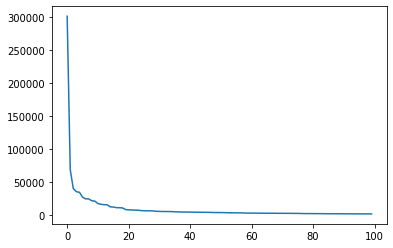

In [18]:

import matplotlib.pyplot as plt
%matplotlib inline

from collections import Counter

wc = Counter()
for text in corpus_dicours:
    wc.update(text.split(" "))
    
freq = [f for _,f in wc.most_common(100)]

plt.plot(freq[:100])
print(wc.most_common(100))

On remaque ici qu'à peu prés une 20 ou 30 de mots se répètent globalement beaucoup plus souvent que le reste , on cosidére que tout les mots les mots ayant une fréquence de 10000 ou plus ne sont pas discrimants.

In [ ]:
# !pip install --upgrade Pillow


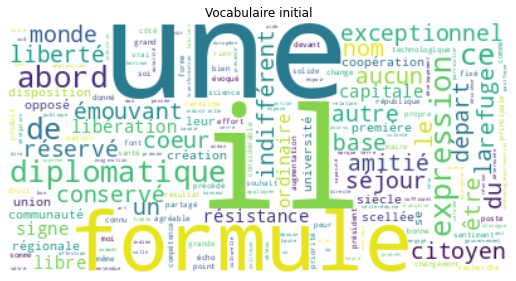

In [ ]:

from wordcloud import WordCloud
import matplotlib.pyplot as plt

wordcloud = WordCloud(background_color = 'white').generate(' '.join(vectorizer_1.vocabulary_.keys()))
plt.figure(figsize=(9, 8))
plt.imshow(wordcloud,interpolation='bilinear')
plt.axis("off")
plt.title('Vocabulaire initial')
plt.show();


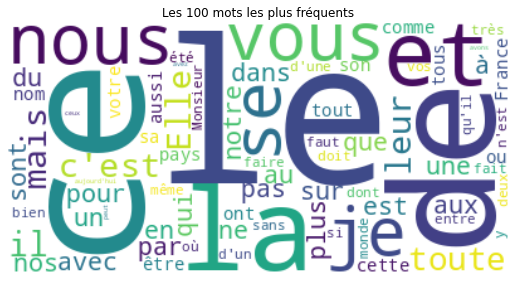

In [ ]:
plus_frequents_100 = dict(wc.most_common(100))
wordcloud = WordCloud(background_color = 'white').generate(' '.join(plus_frequents_100))
plt.figure(figsize=(9, 8))
plt.imshow(wordcloud,interpolation='bilinear')
plt.axis("off")
plt.title('Les 100 mots les plus fréquents')
plt.show();

-    Les 100 mots les plus discriminats au sens de odds ratio :

Lorsqu'on parle de mots discriminants en termes d'odds ratio, on fait généralement référence à des mots qui sont fortement associés à une certaine catégorie ou classe par rapport à une autre. Dans ce contexte, nous comparons l'occurrence d'un mot dans une catégorie par rapport à son occurrence dans une autre catégorie.

$\text{Odds ratio}(w) = \frac{\text{Fréquence de } w \text{ dans la classe M} *( { 1 - \text{Fréquence de } w \text{ dans la classe C}}) }{\text{Fréquence de } w \text{ dans la classe C} *( { 1 - \text{Fréquence de } w \text{ dans la classe M}}) }$

In [ ]:
from scipy.stats.contingency import odds_ratio
def calculate_odds_ratios(mitterrand_counts, chirac_counts):
    odds_ratios = {}
    for word in mitterrand_counts.keys():

        count_mitterrand = mitterrand_counts[word] + 0.5 # Avec une correction de Yates pour eviter les div par zerro
        count_chirac = chirac_counts.get(word, 0)+ 0.5
        
        total_mitterrand = sum(mitterrand_counts.values())
        total_chirac = sum(chirac_counts.values())

        odds_ratio = (count_mitterrand * (total_chirac - count_chirac)) / ((count_chirac * (total_mitterrand - count_mitterrand)))
        odds_ratios[word] = odds_ratio
    
    return odds_ratios

In [ ]:
mitterrand_counts =  Counter(' '.join(data_frame_discours[data_frame_discours['label']==-1].text).split())
chirac_counts = Counter(' '.join(data_frame_discours[data_frame_discours['label']==1].text).split())
odds_ratios = calculate_odds_ratios(mitterrand_counts, chirac_counts)

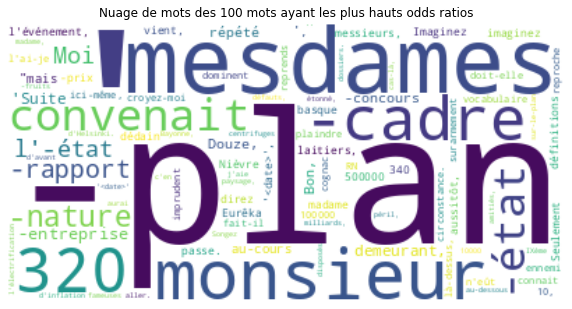

In [ ]:
sorted_odds_ratios = sorted(odds_ratios.items(), key=lambda x: x[1], reverse=True)
top_100_odds_ratios = dict(sorted_odds_ratios[:100])


# Générer le nuage de mots
wc = WordCloud(background_color='white').generate_from_frequencies(top_100_odds_ratios)

# Afficher le nuage de mots
plt.figure(figsize=(10, 8))
plt.title('Nuage de mots des 100 mots ayant les plus hauts odds ratios')
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()


Sur cette figure nous avons la liste des 100 mots les plus caractéristiques ou les plus importants pour les discours de Mitterrand par rapport à ceux de Chirac. 

- Quelle est la distribution d'apparition des mots (Zipf)


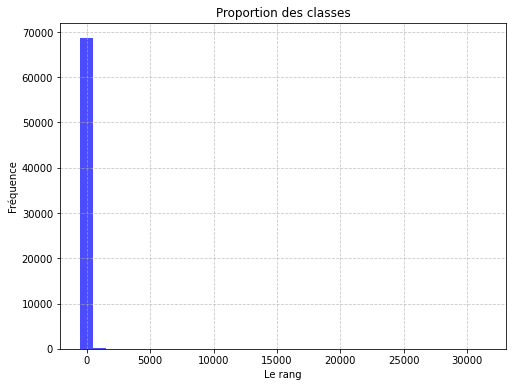

In [ ]:
discours_sans_ponctuation = cmn.suppression_ponctuation(' '.join(data_frame_discours.text))
word_counts = Counter(discours_sans_ponctuation.split())
sorted_words = sorted(word_counts, key=word_counts.get, reverse=True)

word_freqs = [word_counts[sorted_words[i]] for i in range(0,len(sorted_words),1000)]
ranks = np.arange(1,  len(sorted_words) + 1, 1000)  # Rangs des mots échantillonnés avec le pas


plt.figure(figsize=(8, 6)) 
plt.bar(ranks, word_freqs, color='b', alpha=0.7, width=1000)  # Utiliser le pas comme largeur de barre

# On ajoute des titres et des étiquettes
plt.title('Proportion des classes')
plt.xlabel('Le rang')
plt.ylabel('Fréquence')

plt.grid(True, linestyle='--', alpha=0.7)

# On afffiche
plt.show()

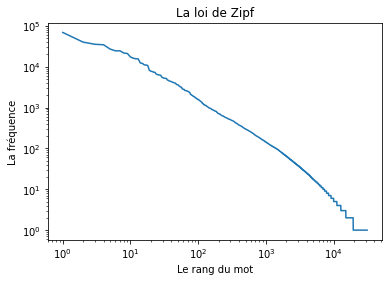

In [ ]:
word_freqs = [word_counts[w] for w in sorted_words]
ranks = range(1, len(sorted_words) + 1)
plt.title('La loi de Zipf')
plt.plot(ranks, word_freqs)

plt.xlabel('Le rang du mot')
plt.ylabel('La fréquence')
plt.xscale('log')
plt.yscale('log')
plt.show()

En résumé, le graphe représentant la loi de Zipf nous permet de bien visualiser la distribution des fréquences des mots dans un corpus de texte, en effet, nous constatons une décroissance très rapide de la fréquence des mots en fonction de leur rang.

- Les 100 bigrammes les plus fréquents : 

In [ ]:
vectorizer_bigram = CountVectorizer(ngram_range=(2, 2))
corpus_dicours = data_frame_discours.text
corpus_dicours_sparse_mat_bigram = vectorizer_bigram.fit_transform(corpus_dicours) # Output is a sparse matrix
print("Taille initiale du vocabulaire avec des bigrammes :",len(vectorizer_bigram.get_feature_names_out()))


Taille initiale du vocabulaire avec des bigrammes : 311838


In [ ]:
frequence = np.array(corpus_dicours_sparse_mat_bigram.sum(axis=0))[0]
indices_tries = np.argsort(-frequence, kind='quicksort')

# Trier les sommes des colonnes en utilisant les indices triés
somme_colonnes_triees = [frequence[i] for i in indices_tries]
somme_colonnes_triees

bigrammes = vectorizer_bigram.get_feature_names_out()
bigrammes_100_plus_frequents = [bigrammes[i] for i in indices_tries[:100] ]

In [ ]:
df_bigrams = pd.DataFrame()
for i in range(5):
    df_bigrams[i] =  bigrammes_100_plus_frequents[i*20:(i+1)*20]
df_bigrams

,0,1,2,3,4
0,de la,il est,du monde,de ces,est aussi
1,et de,et des,de cette,par le,par les
2,la france,qui est,le monde,mais aussi,pour le
3,aujourd hui,que les,qu elle,je voudrais,la sécurité
4,dans le,et le,sur la,de son,entre les
5,et la,le président,par la,sur les,de europe
6,qu il,et je,que le,de leur,je souhaite
7,de notre,pour la,est une,de tous,avec les
8,de nos,est pas,pour les,elle est,que on
9,il faut,et qui,de ses,qui sont,nous sommes


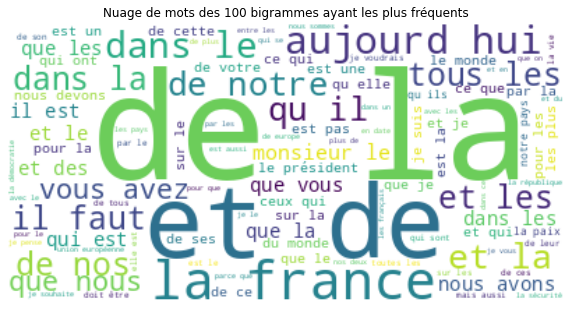

In [ ]:
wc = WordCloud(background_color='white').generate_from_frequencies(dict(zip(bigrammes_100_plus_frequents, somme_colonnes_triees)))

# Afficher le nuage de mots
plt.figure(figsize=(10, 8))
plt.title('Nuage de mots des 100 bigrammes ayant les plus fréquents')
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

In [ ]:
vectorizer_trigram = CountVectorizer(ngram_range=(3,3))
corpus_dicours_sparse_mat_trigram = vectorizer_trigram.fit_transform(corpus_dicours) # Output is a sparse matrix
print("Taille initiale du vocabulaire avec des trigrammes :",len(vectorizer_trigram.get_feature_names_out()))


Taille initiale du vocabulaire avec des trigrammes : 708080


In [ ]:
frequence = np.array(corpus_dicours_sparse_mat_trigram.sum(axis=0))[0]
indices_tries = np.argsort(-frequence, kind='quicksort')

# Trier les sommes des colonnes en utilisant les indices triés
somme_colonnes_triees = [frequence[i] for i in indices_tries]
somme_colonnes_triees

trigrammes = vectorizer_trigram.get_feature_names_out()
trigrammes_100_plus_frequents = [trigrammes[i] for i in indices_tries[:100] ]

In [ ]:
df_trigrams = pd.DataFrame()
for i in range(5):
    df_trigrams[(i+1)*20] =  trigrammes_100_plus_frequents[i*20:(i+1)*20]
df_trigrams

,20,40,60,80,100
0,de la france,de la paix,je sais que,le premier ministre,le respect des
1,monsieur le président,que nous avons,le respect de,plus que jamais,il est pas
2,et de la,de notre pays,ceux qui ont,tous les français,de votre pays
3,dans le monde,je suis heureux,les moyens de,un certain nombre,je me réjouis
4,de la république,de union européenne,au nom de,de la sécurité,ne peut pas
5,mesdames et messieurs,ce qui est,de la nation,la communauté internationale,pour la france
6,la france est,droits de homme,en même temps,on ne peut,de nos concitoyens
7,et la france,la mise en,au delà de,de toutes les,tout ce qui
8,que la france,monsieur le maire,qu il faut,suis heureux de,de la solidarité
9,que vous avez,je souhaite que,est aujourd hui,il faut que,au delà des


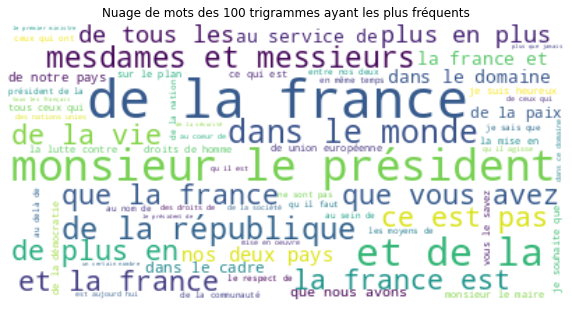

In [ ]:
wc = WordCloud(background_color='white').generate_from_frequencies(dict(zip(trigrammes_100_plus_frequents, somme_colonnes_triees)))

# Afficher le nuage de mots
plt.figure(figsize=(10, 8))
plt.title('Nuage de mots des 100 trigrammes ayant les plus fréquents')
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

- Stopwords : 

In [ ]:
# French stop words: nltk
# nltk.download('stopwords')
from nltk.corpus import stopwords
final_stopwords_list =  stopwords.words('french')
print(final_stopwords_list)
vectorizer_count_stopwords = CountVectorizer(stop_words=final_stopwords_list)
#vectorizer = TfidfVectorizer(stop_words=final_stopwords_list)
vectorizer_count_stopwords.fit_transform(corpus_dicours) # Output is a sparse matrix


['au', 'aux', 'avec', 'ce', 'ces', 'dans', 'de', 'des', 'du', 'elle', 'en', 'et', 'eux', 'il', 'ils', 'je', 'la', 'le', 'les', 'leur', 'lui', 'ma', 'mais', 'me', 'même', 'mes', 'moi', 'mon', 'ne', 'nos', 'notre', 'nous', 'on', 'ou', 'par', 'pas', 'pour', 'qu', 'que', 'qui', 'sa', 'se', 'ses', 'son', 'sur', 'ta', 'te', 'tes', 'toi', 'ton', 'tu', 'un', 'une', 'vos', 'votre', 'vous', 'c', 'd', 'j', 'l', 'à', 'm', 'n', 's', 't', 'y', 'été', 'étée', 'étées', 'étés', 'étant', 'étante', 'étants', 'étantes', 'suis', 'es', 'est', 'sommes', 'êtes', 'sont', 'serai', 'seras', 'sera', 'serons', 'serez', 'seront', 'serais', 'serait', 'serions', 'seriez', 'seraient', 'étais', 'était', 'étions', 'étiez', 'étaient', 'fus', 'fut', 'fûmes', 'fûtes', 'furent', 'sois', 'soit', 'soyons', 'soyez', 'soient', 'fusse', 'fusses', 'fût', 'fussions', 'fussiez', 'fussent', 'ayant', 'ayante', 'ayantes', 'ayants', 'eu', 'eue', 'eues', 'eus', 'ai', 'as', 'avons', 'avez', 'ont', 'aurai', 'auras', 'aura', 'aurons', 'aur

<57413x28400 sparse matrix of type '<class 'numpy.int64'>'
	with 652540 stored elements in Compressed Sparse Row format>

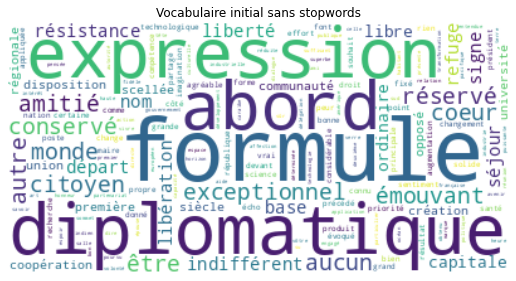

In [ ]:
wordcloud = WordCloud(background_color = 'white').generate(' '.join(vectorizer_count_stopwords.vocabulary_.keys()))
plt.figure(figsize=(9, 8))
plt.imshow(wordcloud,interpolation='bilinear')
plt.axis("off")
plt.title('Vocabulaire initial sans stopwords')
plt.show();